# Prépration du fichier



In [24]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
# chargement csv

df=pd.read_csv("owid-energy-data.csv")

In [3]:
df

,country,year,iso_code,population,gdp,biofuel_cons_change_pct,biofuel_cons_change_twh,biofuel_cons_per_capita,biofuel_consumption,biofuel_elec_per_capita,...,solar_share_elec,solar_share_energy,wind_cons_change_pct,wind_cons_change_twh,wind_consumption,wind_elec_per_capita,wind_electricity,wind_energy_per_capita,wind_share_elec,wind_share_energy
0,ASEAN (Ember),2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
1,ASEAN (Ember),2001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
2,ASEAN (Ember),2002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
3,ASEAN (Ember),2003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
4,ASEAN (Ember),2004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23190,Zimbabwe,2020,ZWE,15526887.0,2.317871e+10,NaN,0.0,0.0,0.0,6.440441,...,0.298063,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23191,Zimbabwe,2021,ZWE,15797220.0,2.514009e+10,NaN,0.0,0.0,0.0,6.963251,...,0.233372,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23192,Zimbabwe,2022,ZWE,16069061.0,2.590159e+10,NaN,0.0,0.0,0.0,6.845453,...,0.335570,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23193,Zimbabwe,2023,ZWE,16340829.0,NaN,NaN,0.0,0.0,0.0,7.343568,...,0.361011,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN


In [4]:
#création fonction diagnostic
def diagnostic_df(df):
    info_list = []
    for col in df.columns:
        data = df[col]
        info = {
            "colonne": col,
            "dtype": data.dtype,
            "nb_valeurs_uniques": data.nunique(dropna=True),
            "nb_valeurs_manquantes": data.isna().sum(),
            "%_valeurs_manquantes": round(data.isna().mean() * 100, 2),
            "exemple_valeur": data.dropna().iloc[0] if data.dropna().shape[0] > 0 else None,
        }
        if np.issubdtype(data.dtype, np.number):
            info.update({
                "min": round(data.min(), 2),
                "max": round(data.max(), 2),
                "moyenne": round(data.mean(), 2),
                "médiane": round(data.median(), 2)
            })
        else:
            info.update({"min": None, "max": None, "moyenne": None, "médiane": None})
        info_list.append(info)
    return pd.DataFrame(info_list).sort_values(by="%_valeurs_manquantes", ascending=False)


In [5]:
diagnostic_df(df)

,colonne,dtype,nb_valeurs_uniques,nb_valeurs_manquantes,%_valeurs_manquantes,exemple_valeur,min,max,moyenne,médiane
5,biofuel_cons_change_pct,float64,1801,21125,91.08,10.361485,-100.00,6.373060e+03,4.348000e+01,6.70
114,solar_cons_change_pct,float64,2208,20680,89.16,24.497566,-100.00,2.180000e+04,1.244000e+02,28.41
73,nuclear_cons_change_pct,float64,2357,20616,88.88,35.414017,-100.00,1.120000e+04,3.243000e+01,3.32
122,wind_cons_change_pct,float64,2434,20397,87.94,170.0,-100.00,2.423849e+05,2.904100e+02,18.35
96,other_renewables_cons_change_pct,float64,3730,19207,82.81,0.609757,-100.00,2.113133e+04,3.276000e+01,5.06
...,...,...,...,...,...,...,...,...,...,...
88,oil_prod_change_twh,float64,8521,5466,23.57,0.0,-6455.25,5.856430e+03,2.393000e+01,0.00
90,oil_production,float64,8574,5203,22.43,0.0,0.00,5.283105e+04,1.230350e+03,1.90
3,population,float64,18663,4471,19.28,4707744.0,1776.00,8.161973e+09,1.059285e+08,6951653.00
1,year,int64,125,0,0.00,2000,1900.00,2.024000e+03,1.975860e+03,1985.00


In [6]:
print(list(df.columns))

['country', 'year', 'iso_code', 'population', 'gdp', 'biofuel_cons_change_pct', 'biofuel_cons_change_twh', 'biofuel_cons_per_capita', 'biofuel_consumption', 'biofuel_elec_per_capita', 'biofuel_electricity', 'biofuel_share_elec', 'biofuel_share_energy', 'carbon_intensity_elec', 'coal_cons_change_pct', 'coal_cons_change_twh', 'coal_cons_per_capita', 'coal_consumption', 'coal_elec_per_capita', 'coal_electricity', 'coal_prod_change_pct', 'coal_prod_change_twh', 'coal_prod_per_capita', 'coal_production', 'coal_share_elec', 'coal_share_energy', 'electricity_demand', 'electricity_demand_per_capita', 'electricity_generation', 'electricity_share_energy', 'energy_cons_change_pct', 'energy_cons_change_twh', 'energy_per_capita', 'energy_per_gdp', 'fossil_cons_change_pct', 'fossil_cons_change_twh', 'fossil_elec_per_capita', 'fossil_electricity', 'fossil_energy_per_capita', 'fossil_fuel_consumption', 'fossil_share_elec', 'fossil_share_energy', 'gas_cons_change_pct', 'gas_cons_change_twh', 'gas_consu

**liste des colonnes jugée inutile** :
-biofuel_cons_change_pc
- biofuel_cons_change_tw
- biofuel_cons_per_capit
- biofuel_consumptio
- biofuel_elec_per_capit
- biofuel_electricit
- biofuel_share_ele,biofuel_share_energcarbon_intensity_ele,coal_cons_change_pc,coal_cons_change_twcoal_prod_change_pc,coal_prod_change_tw, energy_cons_change_pc,energy_cons_change_tw,fossil_cons_change_pc,fossil_cons_change_twgas_cons_change_pc,gas_cons_change_tw,gas_prod_change_pc,gas_prod_change_twhydro_cons_change_pc,hydro_cons_change_tw,low_carbon_cons_change_pc,low_carbon_cons_change_twnuclear_cons_change_pc,nuclear_cons_change_twoil_cons_change_pc,oil_cons_change_twoil_prod_change_pc,other_renewables_energy_per_capitother_renewables_share_eleother_renewables_share_energoil_prod_change_tw,other_renewable_consumptio,other_renewable_electricitother_renewable_exc_biofuel_electricit,other_renewables_cons_change_pc,other_renewables_cons_change_tw,other_renewables_elec_per_capit,other_renewables_elec_per_capita_exc_biofueother_renewables_share_elec_exc_biofue,renewables_cons_change_pc,renewables_cons_change_twsolar_cons_change_pc,solar_cons_change_twwind_cons_change_pc,wind_cons_change_tw


In [7]:

df=df.drop(['biofuel_cons_change_pct', 'biofuel_cons_change_twh', 'biofuel_cons_per_capita', 'biofuel_consumption', 'biofuel_elec_per_capita', 'biofuel_electricity', 'biofuel_share_elec', 'biofuel_share_energy','carbon_intensity_elec', 'coal_cons_change_pct', 'coal_cons_change_twh','coal_prod_change_pct', 'coal_prod_change_twh',  'energy_cons_change_pct', 'energy_cons_change_twh', 'fossil_cons_change_pct', 'fossil_cons_change_twh','gas_cons_change_pct', 'gas_cons_change_twh', 'gas_prod_change_pct', 'gas_prod_change_twh','hydro_cons_change_pct', 'hydro_cons_change_twh', 'low_carbon_cons_change_pct', 'low_carbon_cons_change_twh','nuclear_cons_change_pct', 'nuclear_cons_change_twh','oil_cons_change_pct', 'oil_cons_change_twh','oil_prod_change_pct', 'other_renewables_energy_per_capita','other_renewables_share_elec','other_renewables_share_energy','oil_prod_change_twh', 'other_renewable_consumption', 'other_renewable_electricity','other_renewable_exc_biofuel_electricity', 'other_renewables_cons_change_pct', 'other_renewables_cons_change_twh', 'other_renewables_elec_per_capita', 'other_renewables_elec_per_capita_exc_biofuel','other_renewables_share_elec_exc_biofuel', 'renewables_cons_change_pct', 'renewables_cons_change_twh','solar_cons_change_pct', 'solar_cons_change_twh','wind_cons_change_pct', 'wind_cons_change_twh'],axis=1)

In [8]:
df

,country,year,iso_code,population,gdp,coal_cons_per_capita,coal_consumption,coal_elec_per_capita,coal_electricity,coal_prod_per_capita,...,solar_electricity,solar_energy_per_capita,solar_share_elec,solar_share_energy,wind_consumption,wind_elec_per_capita,wind_electricity,wind_energy_per_capita,wind_share_elec,wind_share_energy
0,ASEAN (Ember),2000,NaN,NaN,NaN,NaN,NaN,NaN,76.029999,NaN,...,0.00,NaN,0.000000,NaN,NaN,NaN,0.0,NaN,0.0,NaN
1,ASEAN (Ember),2001,NaN,NaN,NaN,NaN,NaN,NaN,86.260002,NaN,...,0.00,NaN,0.000000,NaN,NaN,NaN,0.0,NaN,0.0,NaN
2,ASEAN (Ember),2002,NaN,NaN,NaN,NaN,NaN,NaN,93.430000,NaN,...,0.00,NaN,0.000000,NaN,NaN,NaN,0.0,NaN,0.0,NaN
3,ASEAN (Ember),2003,NaN,NaN,NaN,NaN,NaN,NaN,102.010002,NaN,...,0.00,NaN,0.000000,NaN,NaN,NaN,0.0,NaN,0.0,NaN
4,ASEAN (Ember),2004,NaN,NaN,NaN,NaN,NaN,NaN,115.010002,NaN,...,0.00,NaN,0.000000,NaN,NaN,NaN,0.0,NaN,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23190,Zimbabwe,2020,ZWE,15526887.0,2.317871e+10,NaN,NaN,176.468079,2.740000,1306.886353,...,0.02,NaN,0.298063,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23191,Zimbabwe,2021,ZWE,15797220.0,2.514009e+10,NaN,NaN,158.888718,2.510000,1537.672607,...,0.02,NaN,0.233372,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23192,Zimbabwe,2022,ZWE,16069061.0,2.590159e+10,NaN,NaN,181.715668,2.920000,1839.164185,...,0.03,NaN,0.335570,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23193,Zimbabwe,2023,ZWE,16340829.0,NaN,NaN,NaN,165.230301,2.700000,2289.525391,...,0.03,NaN,0.361011,NaN,NaN,0.0,0.0,NaN,0.0,NaN


In [9]:
#filtrage des données pour ne garder que celle avec : Year >= 1960

df=df[df["year"] >=1960]

print(df)



             country  year iso_code  population           gdp  \
0      ASEAN (Ember)  2000      NaN         NaN           NaN   
1      ASEAN (Ember)  2001      NaN         NaN           NaN   
2      ASEAN (Ember)  2002      NaN         NaN           NaN   
3      ASEAN (Ember)  2003      NaN         NaN           NaN   
4      ASEAN (Ember)  2004      NaN         NaN           NaN   
...              ...   ...      ...         ...           ...   
23190       Zimbabwe  2020      ZWE  15526887.0  2.317871e+10   
23191       Zimbabwe  2021      ZWE  15797220.0  2.514009e+10   
23192       Zimbabwe  2022      ZWE  16069061.0  2.590159e+10   
23193       Zimbabwe  2023      ZWE  16340829.0           NaN   
23194       Zimbabwe  2024      ZWE  16634366.0           NaN   

       coal_cons_per_capita  coal_consumption  coal_elec_per_capita  \
0                       NaN               NaN                   NaN   
1                       NaN               NaN                   NaN   
2     

In [10]:
#suppression des lignes qui ont un iso_code = NaN

df = df.dropna(subset=["iso_code"])
print(df)

           country  year iso_code  population           gdp  \
85     Afghanistan  1960      AFG   9035048.0  1.303325e+10   
86     Afghanistan  1961      AFG   9214082.0  1.314629e+10   
87     Afghanistan  1962      AFG   9404410.0  1.336763e+10   
88     Afghanistan  1963      AFG   9604491.0  1.363030e+10   
89     Afghanistan  1964      AFG   9814317.0  1.387050e+10   
...            ...   ...      ...         ...           ...   
23190     Zimbabwe  2020      ZWE  15526887.0  2.317871e+10   
23191     Zimbabwe  2021      ZWE  15797220.0  2.514009e+10   
23192     Zimbabwe  2022      ZWE  16069061.0  2.590159e+10   
23193     Zimbabwe  2023      ZWE  16340829.0           NaN   
23194     Zimbabwe  2024      ZWE  16634366.0           NaN   

       coal_cons_per_capita  coal_consumption  coal_elec_per_capita  \
85                      NaN               NaN                   NaN   
86                      NaN               NaN                   NaN   
87                      NaN   

In [11]:
diagnostic_df(df)

,colonne,dtype,nb_valeurs_uniques,nb_valeurs_manquantes,%_valeurs_manquantes,exemple_valeur,min,max,moyenne,médiane
16,electricity_share_energy,float64,3145,8434,72.84,4.702099,1.04,6.900000e+01,16.21,15.05
12,coal_share_energy,float64,4041,7120,61.49,3.287837,0.00,8.916000e+01,16.95,9.18
53,nuclear_share_energy,float64,1515,7120,61.49,0.0,0.00,4.166000e+01,3.13,0.00
61,oil_share_energy,float64,4425,7120,61.49,62.215881,8.06,1.000000e+02,47.85,44.36
75,solar_share_energy,float64,1676,7120,61.49,0.0,0.00,9.880000e+00,0.23,0.00
...,...,...,...,...,...,...,...,...,...,...
63,primary_energy_consumption,float64,9833,1224,10.57,6.337187,0.00,4.898710e+04,589.59,40.17
3,population,float64,11504,58,0.50,9035048.0,1776.00,1.450936e+09,30198235.96,5819117.00
2,iso_code,object,220,0,0.00,AFG,NaN,NaN,NaN,NaN
0,country,object,220,0,0.00,Afghanistan,NaN,NaN,NaN,NaN


In [12]:
#détermination du nombre de valeur NaN et pourcentage de valeur Nan par pays

#définir nombre de colonne (hors country)
total_cols = len(df.columns) - 1

#calcul du nombre de NaN par pays
nan_counts = df.isna().sum(axis=1) #compte les NaN par ligne
df_nan = df.assign(nan_count = nan_counts) #ajout d'une colonne temporaire avec le nombre de Nan de la ligne

#grouper par pays et calculer la somme du nombre de Nan et le pourcentage de NaN
result = (
    df_nan.groupby("country")
    .agg(
        total_nan = ("nan_count","sum"),
        ratio_nan = ("nan_count",lambda x: (x.sum() / (len(x) * total_cols)) * 100)
    )
    .reset_index()
)

print(result)


            country  total_nan  ratio_nan
0       Afghanistan       3608  69.598765
1           Albania       3568  68.827160
2           Algeria       1167  22.165242
3    American Samoa       2234  62.682379
4            Angola       3478  66.058879
..              ...        ...        ...
215         Vietnam        984  18.689459
216  Western Sahara       2752  77.216611
217           Yemen       2098  57.558299
218          Zambia       3654  69.401709
219        Zimbabwe       3582  68.034188

[220 rows x 3 columns]


In [13]:
# ordonner result par ratior desc

result = result.sort_values(by='ratio_nan', ascending=False)

In [14]:
with pd.option_context('display.max_rows', None):
    print(result)

                              country  total_nan  ratio_nan
5                          Antarctica       3432  96.296296
127              Micronesia (country)       3344  93.827160
204                            Tuvalu       3344  93.827160
49                            Curacao       4440  91.358025
148          Northern Mariana Islands       3122  87.598204
139              Netherlands Antilles       4185  86.111111
216                    Western Sahara       2752  77.216611
80                          Greenland       3791  73.128858
189                          Suriname       3754  72.415123
123                        Martinique       2565  71.969697
146                       North Korea       3725  71.855710
71                      French Guiana       2547  71.464646
137                             Nepal       3685  71.084105
145                              Niue       2524  70.819304
33                           Cameroon       3648  70.370370
46                      Cote d'Ivoire   

In [15]:
df

,country,year,iso_code,population,gdp,coal_cons_per_capita,coal_consumption,coal_elec_per_capita,coal_electricity,coal_prod_per_capita,...,solar_electricity,solar_energy_per_capita,solar_share_elec,solar_share_energy,wind_consumption,wind_elec_per_capita,wind_electricity,wind_energy_per_capita,wind_share_elec,wind_share_energy
85,Afghanistan,1960,AFG,9035048.0,1.303325e+10,NaN,NaN,NaN,NaN,43.250240,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
86,Afghanistan,1961,AFG,9214082.0,1.314629e+10,NaN,NaN,NaN,NaN,58.313568,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
87,Afghanistan,1962,AFG,9404410.0,1.336763e+10,NaN,NaN,NaN,NaN,96.953659,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
88,Afghanistan,1963,AFG,9604491.0,1.363030e+10,NaN,NaN,NaN,NaN,83.914803,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
89,Afghanistan,1964,AFG,9814317.0,1.387050e+10,NaN,NaN,NaN,NaN,93.733780,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23190,Zimbabwe,2020,ZWE,15526887.0,2.317871e+10,NaN,NaN,176.468079,2.74,1306.886353,...,0.02,NaN,0.298063,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23191,Zimbabwe,2021,ZWE,15797220.0,2.514009e+10,NaN,NaN,158.888718,2.51,1537.672607,...,0.02,NaN,0.233372,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23192,Zimbabwe,2022,ZWE,16069061.0,2.590159e+10,NaN,NaN,181.715668,2.92,1839.164185,...,0.03,NaN,0.335570,NaN,NaN,0.0,0.0,NaN,0.0,NaN
23193,Zimbabwe,2023,ZWE,16340829.0,NaN,NaN,NaN,165.230301,2.70,2289.525391,...,0.03,NaN,0.361011,NaN,NaN,0.0,0.0,NaN,0.0,NaN


In [16]:
list(df.columns)

['country',
 'year',
 'iso_code',
 'population',
 'gdp',
 'coal_cons_per_capita',
 'coal_consumption',
 'coal_elec_per_capita',
 'coal_electricity',
 'coal_prod_per_capita',
 'coal_production',
 'coal_share_elec',
 'coal_share_energy',
 'electricity_demand',
 'electricity_demand_per_capita',
 'electricity_generation',
 'electricity_share_energy',
 'energy_per_capita',
 'energy_per_gdp',
 'fossil_elec_per_capita',
 'fossil_electricity',
 'fossil_energy_per_capita',
 'fossil_fuel_consumption',
 'fossil_share_elec',
 'fossil_share_energy',
 'gas_consumption',
 'gas_elec_per_capita',
 'gas_electricity',
 'gas_energy_per_capita',
 'gas_prod_per_capita',
 'gas_production',
 'gas_share_elec',
 'gas_share_energy',
 'greenhouse_gas_emissions',
 'hydro_consumption',
 'hydro_elec_per_capita',
 'hydro_electricity',
 'hydro_energy_per_capita',
 'hydro_share_elec',
 'hydro_share_energy',
 'low_carbon_consumption',
 'low_carbon_elec_per_capita',
 'low_carbon_electricity',
 'low_carbon_energy_per_capi

In [17]:
# Obtenir la liste des valeurs uniques de country
countries = df['country'].unique()

# Afficher toutes les valeurs
print(f"Nombre total de pays : {len(countries)}\n")
print("Liste complète :")
for country in sorted(countries):
    print(country)

Nombre total de pays : 220

Liste complète :
Afghanistan
Albania
Algeria
American Samoa
Angola
Antarctica
Antigua and Barbuda
Argentina
Armenia
Aruba
Australia
Austria
Azerbaijan
Bahamas
Bahrain
Bangladesh
Barbados
Belarus
Belgium
Belize
Benin
Bermuda
Bhutan
Bolivia
Bosnia and Herzegovina
Botswana
Brazil
British Virgin Islands
Brunei
Bulgaria
Burkina Faso
Burundi
Cambodia
Cameroon
Canada
Cape Verde
Cayman Islands
Central African Republic
Chad
Chile
China
Colombia
Comoros
Congo
Cook Islands
Costa Rica
Cote d'Ivoire
Croatia
Cuba
Curacao
Cyprus
Czechia
Democratic Republic of Congo
Denmark
Djibouti
Dominica
Dominican Republic
East Timor
Ecuador
Egypt
El Salvador
Equatorial Guinea
Eritrea
Estonia
Eswatini
Ethiopia
Falkland Islands
Faroe Islands
Fiji
Finland
France
French Guiana
French Polynesia
Gabon
Gambia
Georgia
Germany
Ghana
Gibraltar
Greece
Greenland
Grenada
Guadeloupe
Guam
Guatemala
Guinea
Guinea-Bissau
Guyana
Haiti
Honduras
Hong Kong
Hungary
Iceland
India
Indonesia
Iran
Iraq
Ireland


In [19]:
with pd.option_context('display.max_rows', None):
    print(df.dtypes)

country                           object
year                               int64
iso_code                          object
population                       float64
gdp                              float64
coal_cons_per_capita             float64
coal_consumption                 float64
coal_elec_per_capita             float64
coal_electricity                 float64
coal_prod_per_capita             float64
coal_production                  float64
coal_share_elec                  float64
coal_share_energy                float64
electricity_demand               float64
electricity_demand_per_capita    float64
electricity_generation           float64
electricity_share_energy         float64
energy_per_capita                float64
energy_per_gdp                   float64
fossil_elec_per_capita           float64
fossil_electricity               float64
fossil_energy_per_capita         float64
fossil_fuel_consumption          float64
fossil_share_elec                float64
fossil_share_ene

In [20]:
#export du fichier csv

df.to_csv("owid-energy-data_clean.csv",index=False)

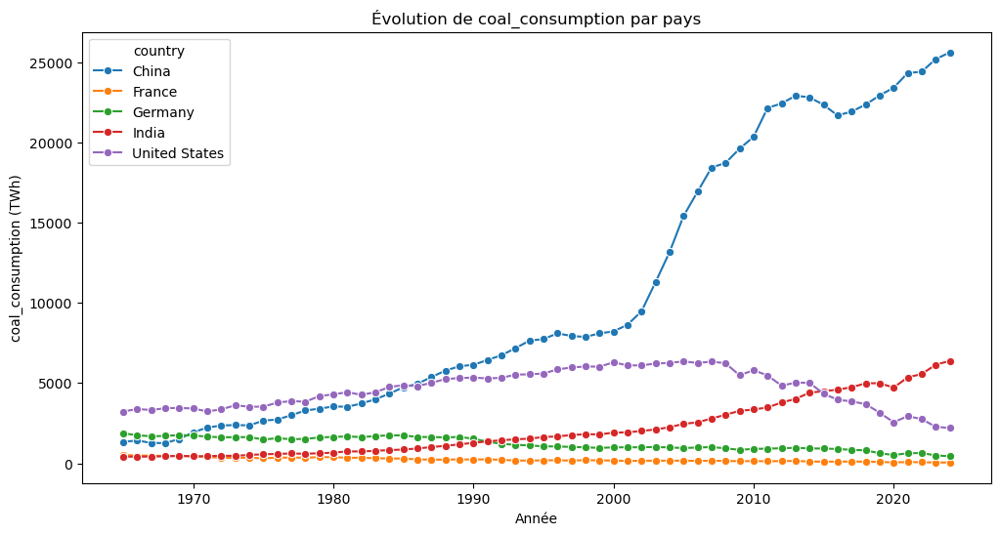

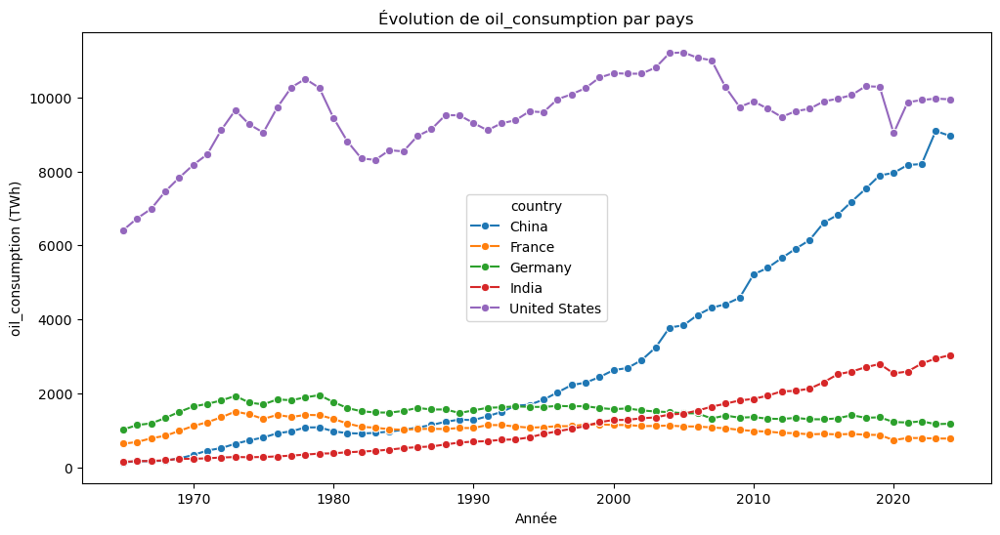

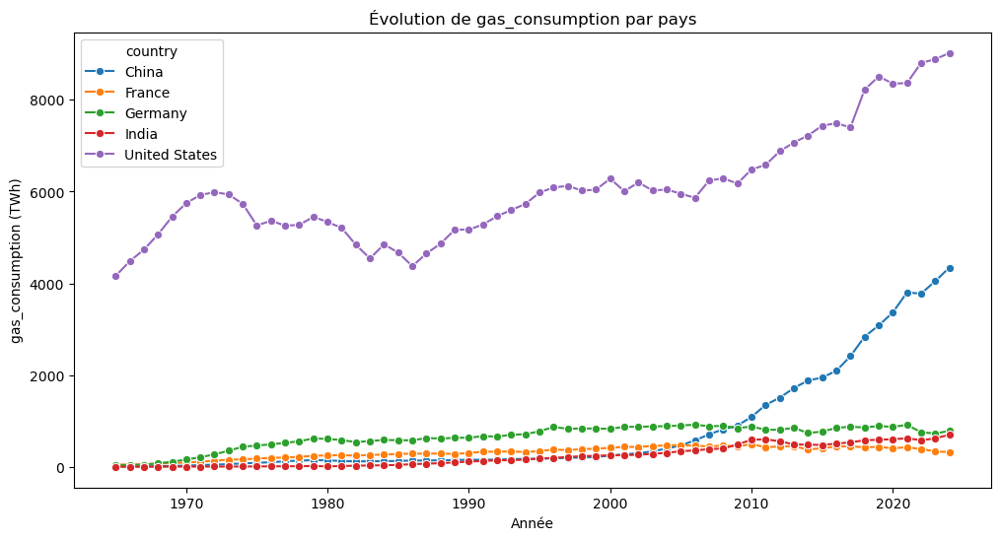

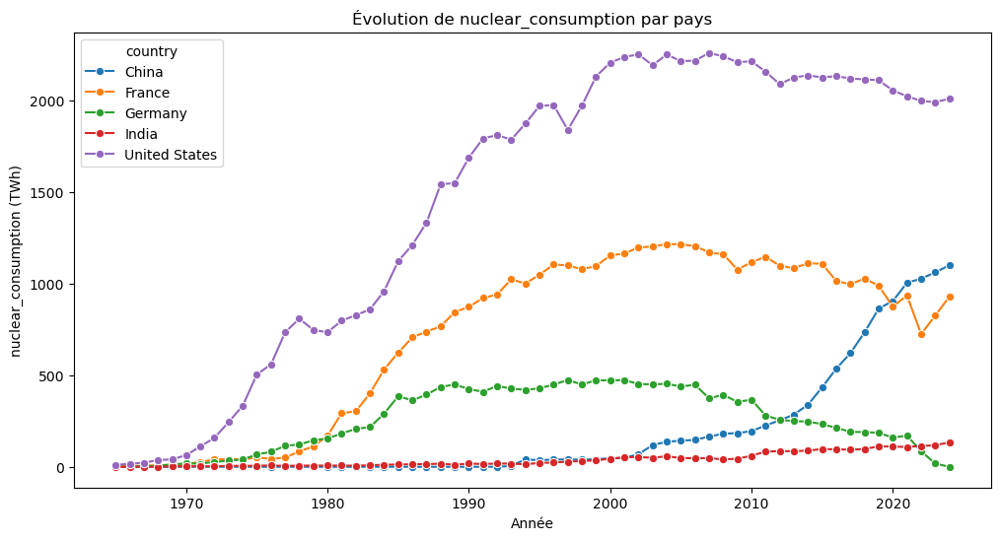

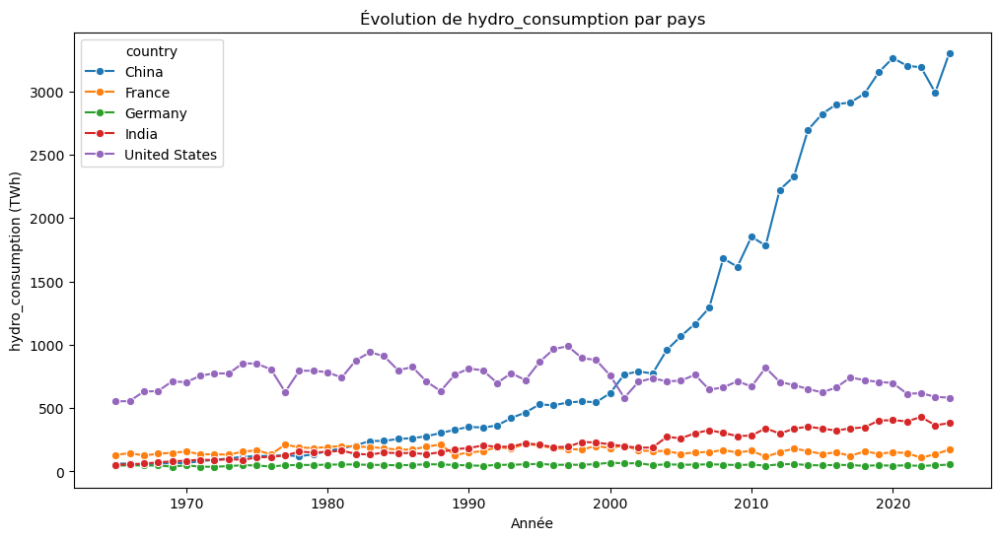

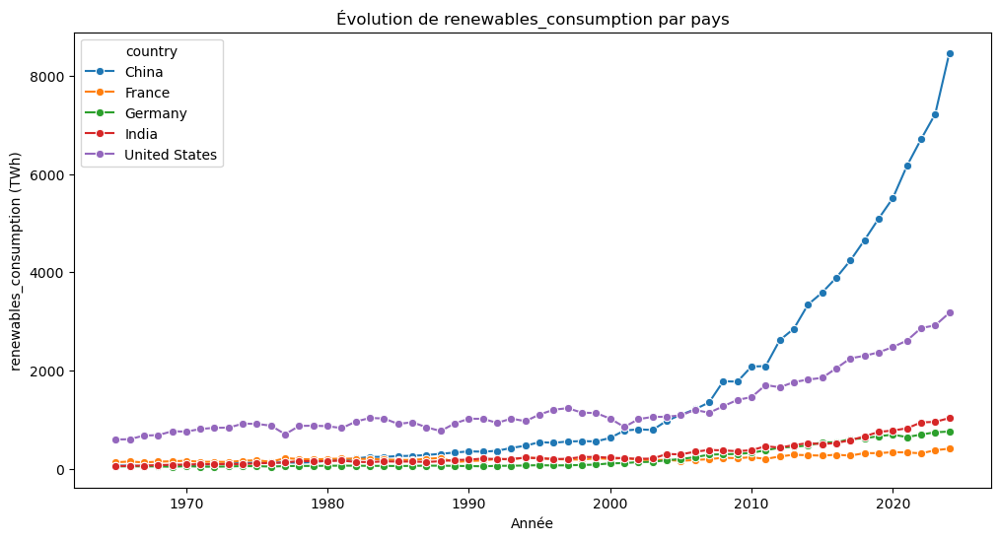

In [26]:
# évolution temporelle de la consommation d'énergie par type pour 5 pays

countries = ['United States', 'France', 'Germany', 'China', 'India']

for col in energy_cols:
    plt.figure(figsize=(12,6))
    sns.lineplot(
        data=df[df['country'].isin(countries)],
        x='year',
        y=col,
        hue='country',
        marker='o'
    )
    plt.title(f"Évolution de {col} par pays")
    plt.xlabel("Année")
    plt.ylabel(f"{col} (TWh)")
    plt.show()


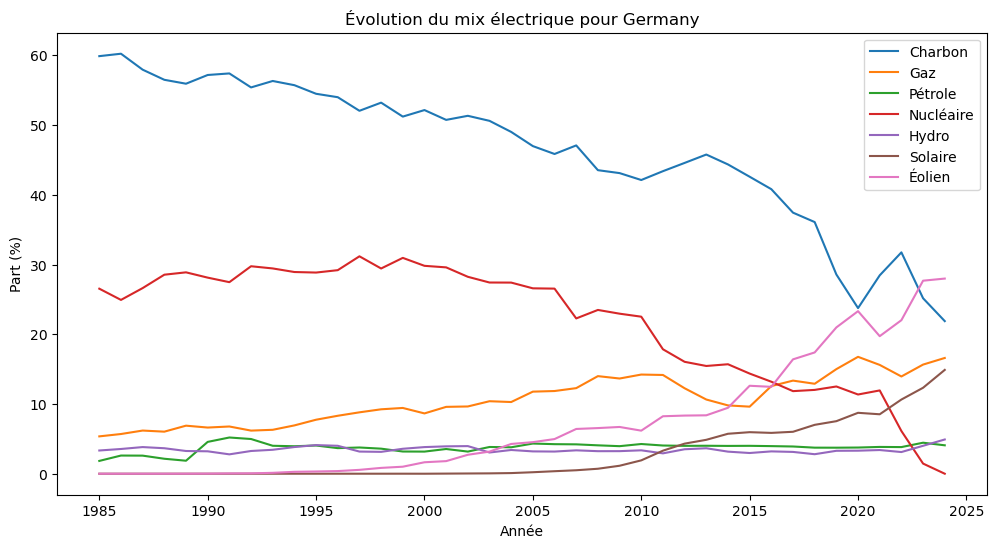

In [27]:
# répartition  des parts dans le mix énergétique

mix_elec_cols = ['coal_share_elec','gas_share_elec','oil_share_elec','nuclear_share_elec','hydro_share_elec','solar_share_elec','wind_share_elec','renewables_share_elec']

# Exemple pour un pays
country_example = 'Germany'
df_country = df[df['country'] == country_example]

plt.figure(figsize=(12,6))
sns.lineplot(
    data=df_country,
    x='year',
    y='coal_share_elec',
    label='Charbon'
)
sns.lineplot(data=df_country, x='year', y='gas_share_elec', label='Gaz')
sns.lineplot(data=df_country, x='year', y='oil_share_elec', label='Pétrole')
sns.lineplot(data=df_country, x='year', y='nuclear_share_elec', label='Nucléaire')
sns.lineplot(data=df_country, x='year', y='hydro_share_elec', label='Hydro')
sns.lineplot(data=df_country, x='year', y='solar_share_elec', label='Solaire')
sns.lineplot(data=df_country, x='year', y='wind_share_elec', label='Éolien')
plt.title(f"Évolution du mix électrique pour {country_example}")
plt.xlabel("Année")
plt.ylabel("Part (%)")
plt.legend()
plt.show()


In [40]:
import plotly.graph_objects as go

# Colonnes des types d'énergie + total
energy_columns = [
    "coal_consumption", "oil_consumption", "gas_consumption",
    "nuclear_consumption", "hydro_consumption", "solar_consumption",
    "wind_consumption", "renewables_consumption", "low_carbon_consumption"
]

df['total_consumption'] = df[energy_columns].sum(axis=1, skipna=True)
energy_columns.append('total_consumption')

df_plot = df[df['iso_code'].notna()]
years = sorted(df_plot['year'].unique())

# Fonction pour créer les frames
def create_frames(energy):
    frames = []
    for year in years:
        df_year = df_plot[df_plot['year'] == year]
        if not df_year.empty:
            frames.append(go.Frame(
                data=[go.Choropleth(
                    locations=df_year['iso_code'],
                    z=df_year[energy],
                    text=df_year['country'],
                    colorscale='YlOrRd',
                    zmin=0,
                    colorbar_title="TWh"
                )],
                name=str(year)  # important : nom de la frame = année
            ))
    return frames

# Figure initiale
df_initial = df_plot[df_plot['year'] == years[0]]
fig = go.Figure(
    data=[go.Choropleth(
        locations=df_initial['iso_code'],
        z=df_initial['total_consumption'],
        text=df_initial['country'],
        colorscale='YlOrRd',
        zmin=0,
        colorbar_title="TWh"
    )],
    layout=go.Layout(
        title=f"Consommation énergétique : Total",
        geo=dict(showframe=False, projection_type='natural earth'),
        updatemenus=[
            # Boutons Play / Pause
            dict(
                type="buttons",
                showactive=False,
                buttons=[
                    dict(
                        label="Play",
                        method="animate",
                        args=[None, {"frame": {"duration": 800, "redraw": True},
                                     "fromcurrent": True,
                                     "transition": {"duration": 300}}]
                    ),
                    dict(
                        label="Pause",
                        method="animate",
                        args=[[None], {"frame": {"duration": 0, "redraw": False},
                                       "mode": "immediate",
                                       "transition": {"duration": 0}}]
                    )
                ],
                x=0.8, y=1.1
            ),
            # Menu déroulant énergie
            dict(
                type="dropdown",
                buttons=[
                    dict(
                        label=energy.replace("_", " "),
                        method="animate",
                        args=[create_frames(energy), {"frame": {"duration": 800, "redraw": True},
                                                     "fromcurrent": True}]
                    ) for energy in energy_columns
                ],
                x=0.1, y=1.1
            )
        ],
        sliders=[dict(
            active=0,
            currentvalue={"prefix": "Année: "},   # Affiche l'année actuelle
            pad={"t": 50},
            steps=[dict(
                method="animate",
                args=[[str(year)], {"frame": {"duration": 800, "redraw": True},
                                    "mode": "immediate",
                                    "transition": {"duration": 300}}],
                label=str(year)
            ) for year in years]
        )]
    ),
    frames=create_frames('total_consumption')
)

fig.show()


In [41]:
import plotly.graph_objects as go

# Colonnes des types d'énergie per capita + total
energy_columns_pc = [
    "coal_cons_per_capita", "oil_energy_per_capita", "gas_energy_per_capita",
    "nuclear_energy_per_capita", "hydro_energy_per_capita", "solar_energy_per_capita",
    "wind_energy_per_capita", "renewables_energy_per_capita", "low_carbon_energy_per_capita"
]

# Calcul de la consommation totale per capita
df['total_consumption_per_capita'] = df[energy_columns_pc].sum(axis=1, skipna=True)
energy_columns_pc.append('total_consumption_per_capita')

# Filtrer les pays avec iso_code
df_plot = df[df['iso_code'].notna()]
years = sorted(df_plot['year'].unique())

# Fonction pour créer les frames pour l'animation
def create_frames_pc(energy):
    frames = []
    for year in years:
        df_year = df_plot[df_plot['year'] == year]
        if not df_year.empty:
            frames.append(go.Frame(
                data=[go.Choropleth(
                    locations=df_year['iso_code'],
                    z=df_year[energy],
                    text=df_year['country'],
                    colorscale='YlGnBu',
                    zmin=0,
                    colorbar_title="kWh/habitant"
                )],
                name=str(year)
            ))
    return frames

# Figure initiale
df_initial = df_plot[df_plot['year'] == years[0]]
fig = go.Figure(
    data=[go.Choropleth(
        locations=df_initial['iso_code'],
        z=df_initial['total_consumption_per_capita'],
        text=df_initial['country'],
        colorscale='YlGnBu',
        zmin=0,
        colorbar_title="kWh/habitant"
    )],
    layout=go.Layout(
        title=f"Consommation énergétique par habitant : Total",
        geo=dict(showframe=False, projection_type='natural earth'),
        updatemenus=[
            # Boutons Play / Pause
            dict(
                type="buttons",
                showactive=False,
                buttons=[
                    dict(
                        label="Play",
                        method="animate",
                        args=[None, {"frame": {"duration": 800, "redraw": True},
                                     "fromcurrent": True,
                                     "transition": {"duration": 300}}]
                    ),
                    dict(
                        label="Pause",
                        method="animate",
                        args=[[None], {"frame": {"duration": 0, "redraw": False},
                                       "mode": "immediate",
                                       "transition": {"duration": 0}}]
                    )
                ],
                x=0.8, y=1.1
            ),
            # Menu déroulant énergie per capita
            dict(
                type="dropdown",
                buttons=[
                    dict(
                        label=energy.replace("_", " "),
                        method="animate",
                        args=[create_frames_pc(energy), {"frame": {"duration": 800, "redraw": True},
                                                        "fromcurrent": True}]
                    ) for energy in energy_columns_pc
                ],
                x=0.1, y=1.1
            )
        ],
        sliders=[dict(
            active=0,
            currentvalue={"prefix": "Année: "},
            pad={"t": 50},
            steps=[dict(
                method="animate",
                args=[[str(year)], {"frame": {"duration": 800, "redraw": True},
                                    "mode": "immediate",
                                    "transition": {"duration": 300}}],
                label=str(year)
            ) for year in years]
        )]
    ),
    frames=create_frames_pc('total_consumption_per_capita')
)

fig.show()
